In [1]:
import pandas as pd
import numpy as np

In [2]:
df = pd.read_csv('uber.csv')
df.head()

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5


In [3]:
df.drop(['Unnamed: 0' , 'key'] , axis=1 , inplace=True)
df.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare_amount        200000 non-null  float64
 1   pickup_datetime    200000 non-null  object 
 2   pickup_longitude   200000 non-null  float64
 3   pickup_latitude    200000 non-null  float64
 4   dropoff_longitude  199999 non-null  float64
 5   dropoff_latitude   199999 non-null  float64
 6   passenger_count    200000 non-null  int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 10.7+ MB


In [5]:
df.isnull().sum()

fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    1
dropoff_latitude     1
passenger_count      0
dtype: int64

In [6]:
df.dropna(inplace=True)

In [7]:
df.isnull().sum()

fare_amount          0
pickup_datetime      0
pickup_longitude     0
pickup_latitude      0
dropoff_longitude    0
dropoff_latitude     0
passenger_count      0
dtype: int64

In [8]:
df.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,199999.000000,199999.000000,199999.000000,199999.000000,199999.000000,199999.000000
mean,11.359892,-72.527631,39.935881,-72.525292,39.923890,1.684543
std,9.901760,11.437815,7.720558,13.117408,6.794829,1.385995
min,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000
25%,6.000000,-73.992065,40.734796,-73.991407,40.733823,1.000000
50%,8.500000,-73.981823,40.752592,-73.980093,40.753042,1.000000
75%,12.500000,-73.967154,40.767158,-73.963658,40.768001,2.000000
max,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000


In [9]:
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 199999 entries, 0 to 199999
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype              
---  ------             --------------   -----              
 0   fare_amount        199999 non-null  float64            
 1   pickup_datetime    199999 non-null  datetime64[ns, UTC]
 2   pickup_longitude   199999 non-null  float64            
 3   pickup_latitude    199999 non-null  float64            
 4   dropoff_longitude  199999 non-null  float64            
 5   dropoff_latitude   199999 non-null  float64            
 6   passenger_count    199999 non-null  int64              
dtypes: datetime64[ns, UTC](1), float64(5), int64(1)
memory usage: 12.2 MB


In [10]:
df['day'] = df['pickup_datetime'].dt.day
df['month'] = df['pickup_datetime'].dt.month
df['year'] = df['pickup_datetime'].dt.year
df['hour'] = df['pickup_datetime'].dt.hour
df.drop('pickup_datetime' , axis=1 , inplace=True)
df.head()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,day,month,year,hour
0,7.5,-73.999817,40.738354,-73.999512,40.723217,1,7,5,2015,19
1,7.7,-73.994355,40.728225,-73.994710,40.750325,1,17,7,2009,20
2,12.9,-74.005043,40.740770,-73.962565,40.772647,1,24,8,2009,21
3,5.3,-73.976124,40.790844,-73.965316,40.803349,3,26,6,2009,8
4,16.0,-73.925023,40.744085,-73.973082,40.761247,5,28,8,2014,17


# EDA

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt

Text(0, 0.5, 'Fare')

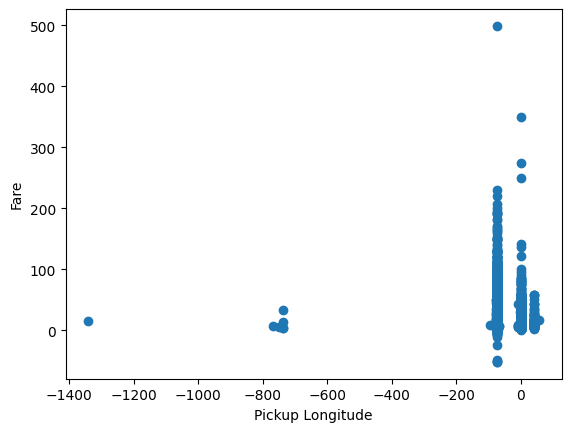

In [12]:
plt.scatter(y = df['fare_amount'] , x = df['pickup_longitude'])
plt.xlabel('Pickup Longitude')
plt.ylabel('Fare')

Text(0, 0.5, 'Fare')

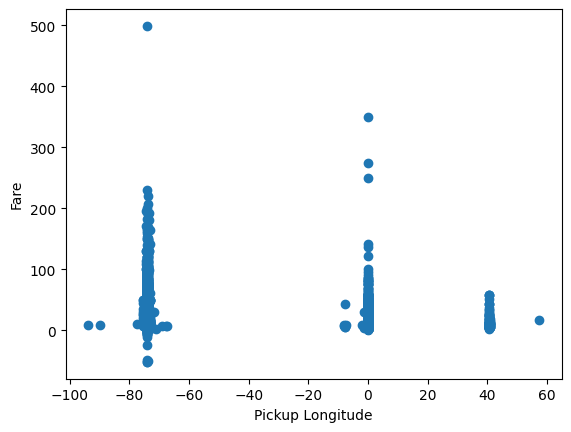

In [13]:
plt.scatter(y = df[~(df['pickup_longitude']<-600)]['fare_amount'] , x = df[~(df['pickup_longitude']<-600)]['pickup_longitude'])
plt.xlabel('Pickup Longitude')
plt.ylabel('Fare')

In [14]:
df = df[~(df['pickup_longitude']<-600)]   # Removing outliers

Text(0, 0.5, 'Fare')

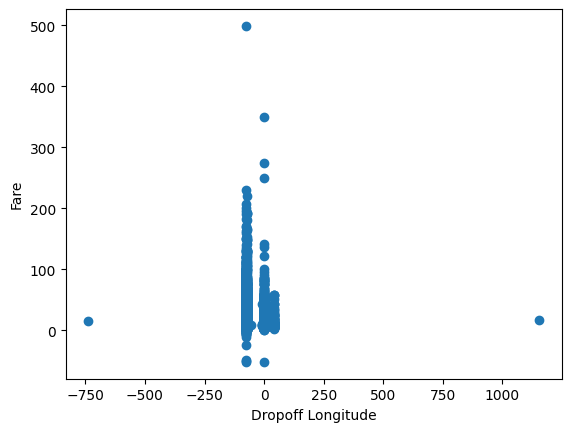

In [15]:
plt.scatter(y = df['fare_amount'] , x = df['dropoff_longitude'])
plt.xlabel('Dropoff Longitude')
plt.ylabel('Fare')

In [16]:
df = df[~((df['dropoff_longitude']<-500) | (df['dropoff_longitude']>1000))]

Text(0, 0.5, 'Fare')

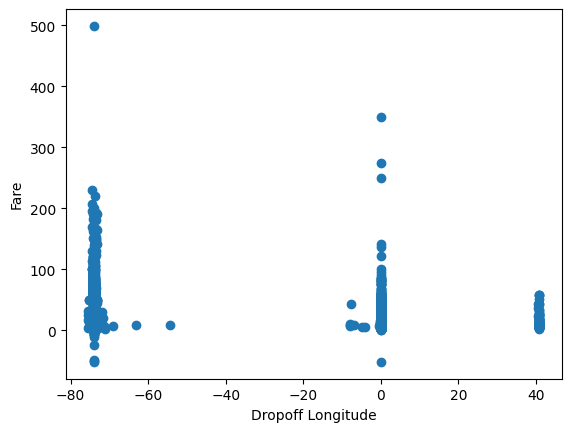

In [17]:
plt.scatter(y = df['fare_amount'] , x = df['dropoff_longitude'])
plt.xlabel('Dropoff Longitude')
plt.ylabel('Fare')

Text(0, 0.5, 'Fare')

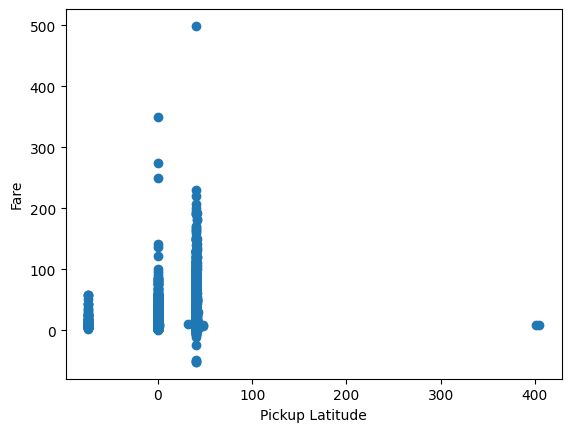

In [18]:
plt.scatter(y = df['fare_amount'] , x = df['pickup_latitude'])
plt.xlabel('Pickup Latitude')
plt.ylabel('Fare')

In [19]:
df = df[~(df['pickup_latitude']>300)]

Text(0, 0.5, 'Fare')

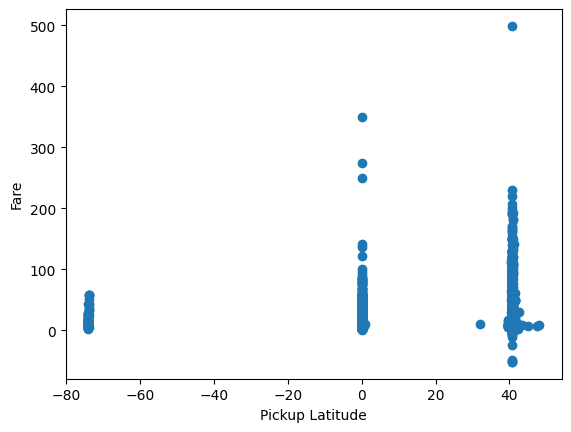

In [20]:
plt.scatter(y = df['fare_amount'] , x = df['pickup_latitude'])
plt.xlabel('Pickup Latitude')
plt.ylabel('Fare')

Text(0, 0.5, 'Fare')

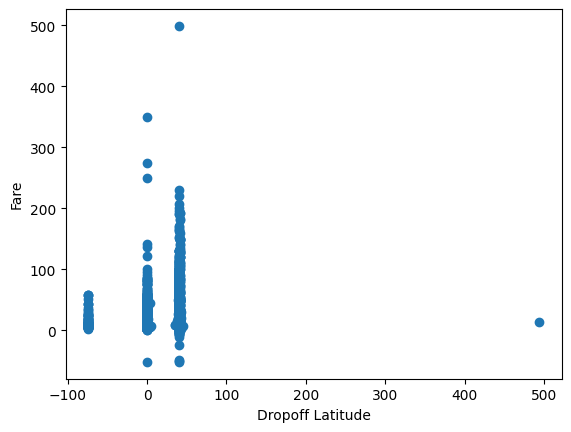

In [21]:
plt.scatter(y = df['fare_amount'] , x = df['dropoff_latitude'])
plt.xlabel('Dropoff Latitude')
plt.ylabel('Fare')

In [22]:
df = df[~(df['dropoff_latitude']>400)]

Text(0, 0.5, 'Fare')

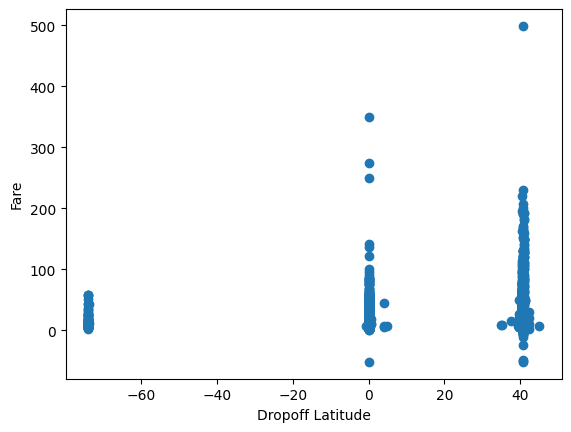

In [23]:
plt.scatter(y = df['fare_amount'] , x = df['dropoff_latitude'])
plt.xlabel('Dropoff Latitude')
plt.ylabel('Fare')

There is no relation of individual column

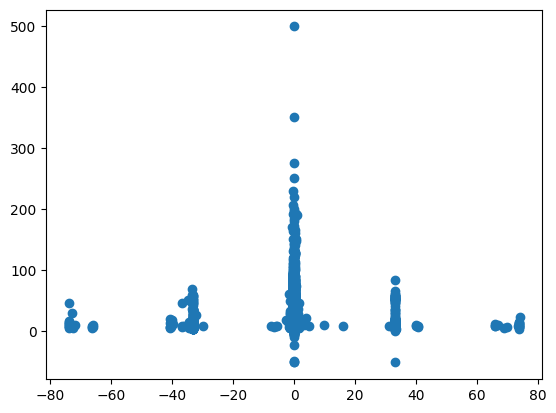

In [24]:
plt.scatter(y = df['fare_amount'] , x = ((df['dropoff_latitude']-df['pickup_latitude'])+(df['dropoff_longitude']-df['pickup_longitude'])))

Text(0, 0.5, 'Longitude Difference')

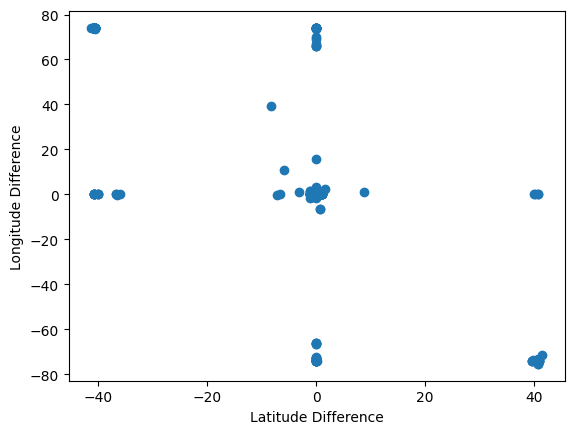

In [25]:
plt.scatter(y = (df['dropoff_longitude']-df['pickup_longitude']) , x = ((df['dropoff_latitude']-df['pickup_latitude'])))
plt.xlabel('Latitude Difference')
plt.ylabel('Longitude Difference')

Text(0, 0.5, 'Longitude Difference')

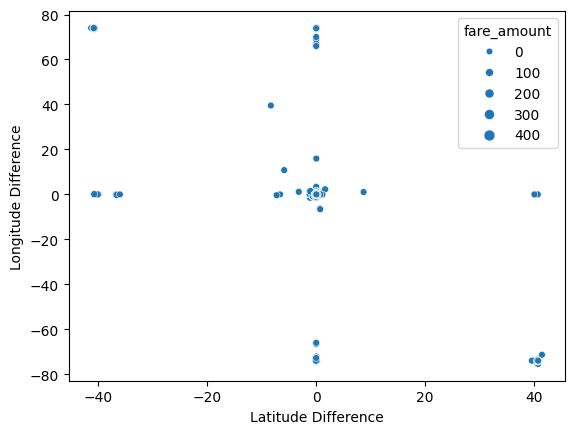

In [26]:
sns.scatterplot(y = (df['dropoff_longitude']-df['pickup_longitude']) , x = (df['dropoff_latitude']-df['pickup_latitude'])
                , size=df['fare_amount'])
plt.xlabel('Latitude Difference')
plt.ylabel('Longitude Difference')

In [27]:
import plotly.express as px
px.scatter_3d(y = abs(df['dropoff_longitude']-df['pickup_longitude']) , x = abs(df['dropoff_latitude']-df['pickup_latitude'])
                , z=df['fare_amount'])

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

Figure({
    'data': [{'hovertemplate': 'x=%{x}<br>y=%{y}<br>z=%{z}<extra></extra>',
              'legendgroup': '',
              'marker': {'color': '#636efa', 'symbol': 'circle'},
              'mode': 'markers',
              'name': '',
              'scene': 'scene',
              'showlegend': False,
              'type': 'scatter3d',
              'x': array([0.01513672, 0.0221    , 0.031877  , ..., 0.063899  , 0.03003693,
                          0.048716  ]),
              'y': array([0.00030518, 0.000355  , 0.042478  , ..., 0.12706   , 0.01390839,
                          0.001113  ]),
              'z': array([ 7.5,  7.7, 12.9, ..., 30.9, 14.5, 14.1])}],
    'layout': {'legend': {'tracegroupgap': 0},
               'margin': {'t': 60},
               'scene': {'domain': {'x': [0.0, 1.0], 'y': [0.0, 1.0]},
                         'xaxis': {'title': {'text': 'x'}},
                         'yaxis': {'title': {'text': 'y'}},
                         'zaxis': {'title': {'text': 'z'}}},
               'template': '...'}
})

<Axes: xlabel='hour', ylabel='fare_amount'>

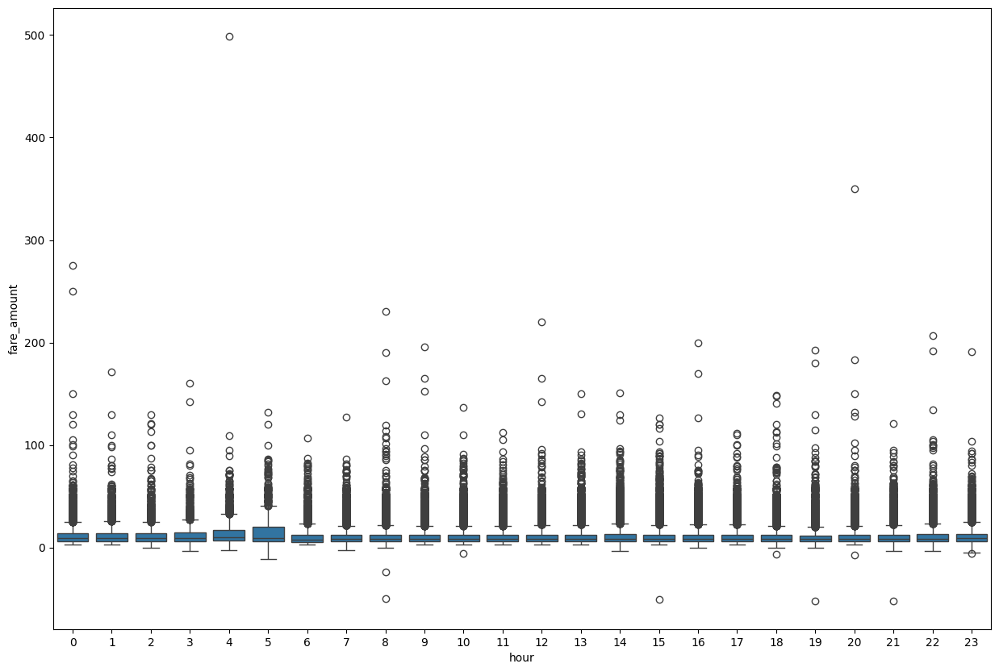

In [30]:
plt.figure(figsize=(15,10))
sns.boxplot(x=df['hour'] , y=df['fare_amount'])

Fares cannot be negative & there are a lot of outliers also

In [32]:
df = df[df['fare_amount']>0]

<Axes: ylabel='fare_amount'>

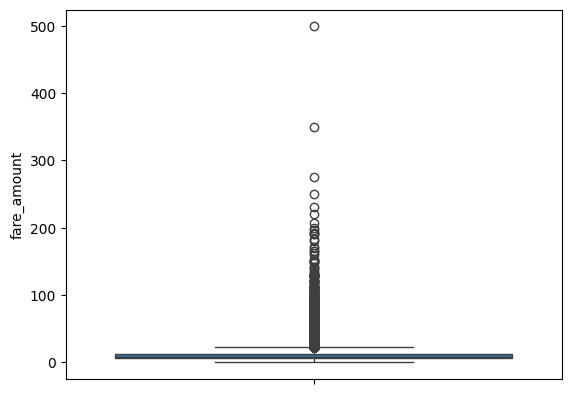

In [34]:
sns.boxplot(df['fare_amount'])

In [39]:
q1 , q3 = df['fare_amount'].quantile([0.25,0.75])
l_limit = q1 - 1.5*(q3-q1)
u_limit = q3 + 1.5*(q3-q1)

df = df[(df['fare_amount']>l_limit)&(df['fare_amount']<u_limit)]

<Axes: ylabel='fare_amount'>

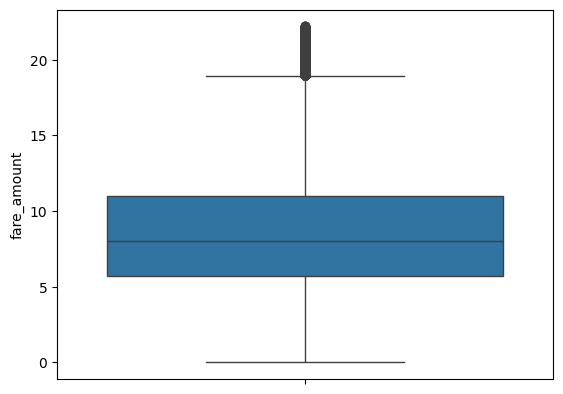

In [40]:
sns.boxplot(df['fare_amount'])

<Axes: xlabel='hour', ylabel='fare_amount'>

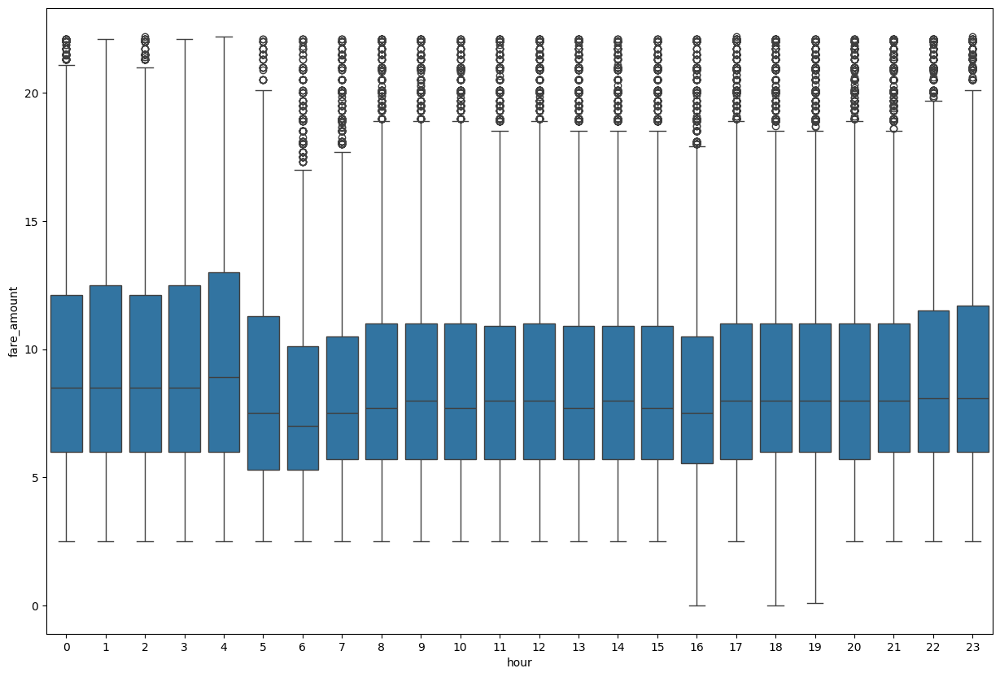

In [41]:
plt.figure(figsize=(15,10))
sns.boxplot(x=df['hour'] , y=df['fare_amount'])

We can see that after 10pm , the fares are slightly high

<Axes: xlabel='day', ylabel='fare_amount'>

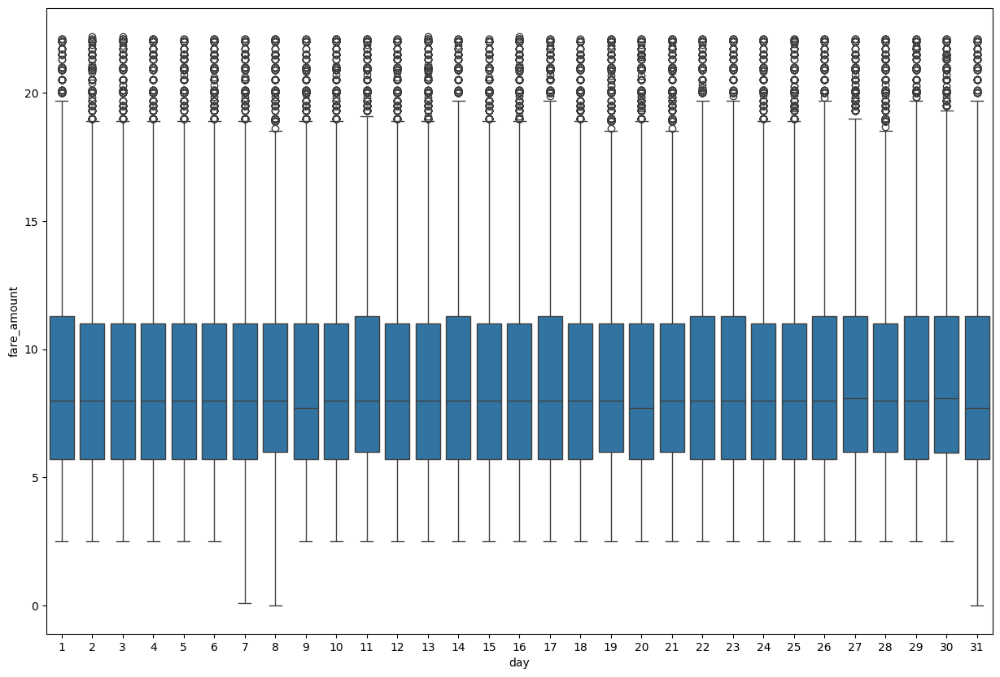

In [44]:
plt.figure(figsize=(15,10))
sns.boxplot(x=df['day'] , y=df['fare_amount'])

<Axes: xlabel='month', ylabel='fare_amount'>

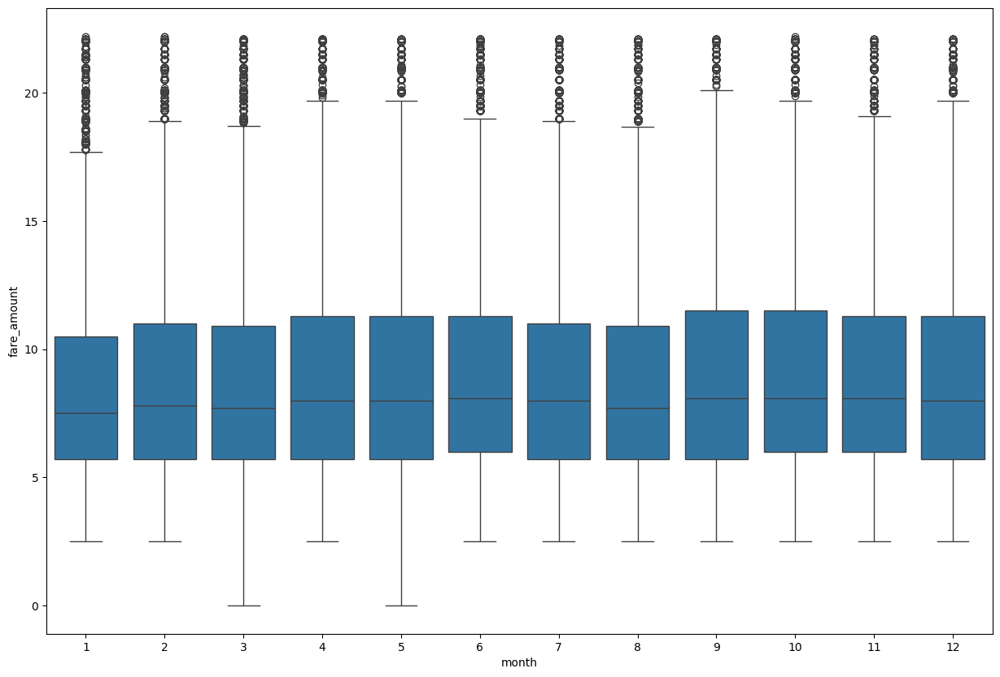

In [45]:
plt.figure(figsize=(15,10))
sns.boxplot(x=df['month'] , y=df['fare_amount'])

<Axes: xlabel='year', ylabel='fare_amount'>

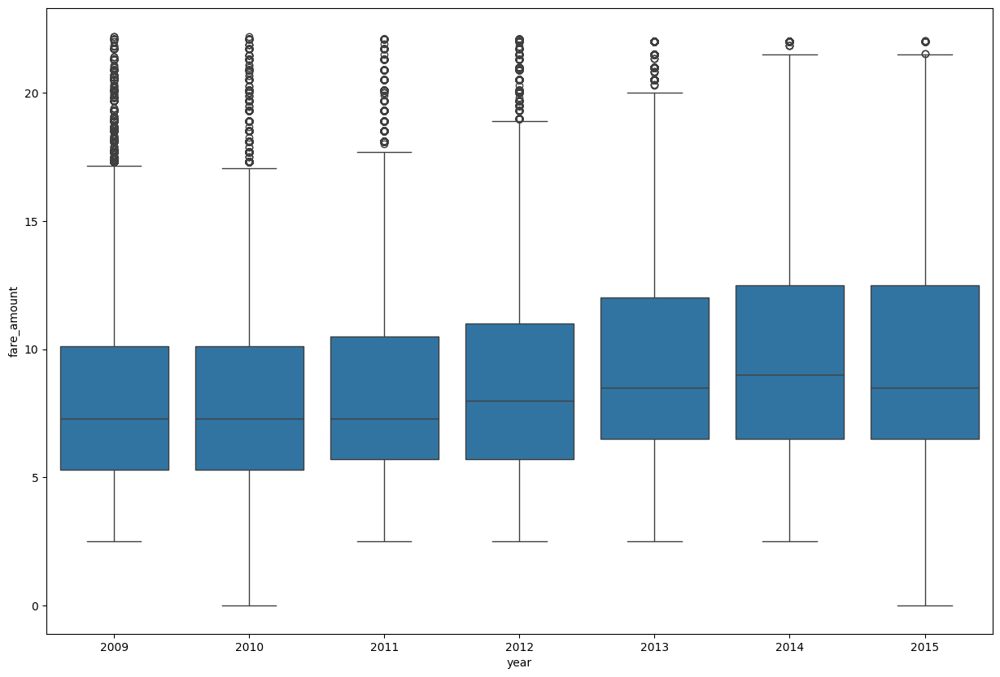

In [46]:
plt.figure(figsize=(15,10))
sns.boxplot(x=df['year'] , y=df['fare_amount'])

We can observe that fares are independent of day and month but are increasing slightly with years

<Axes: xlabel='passenger_count', ylabel='fare_amount'>

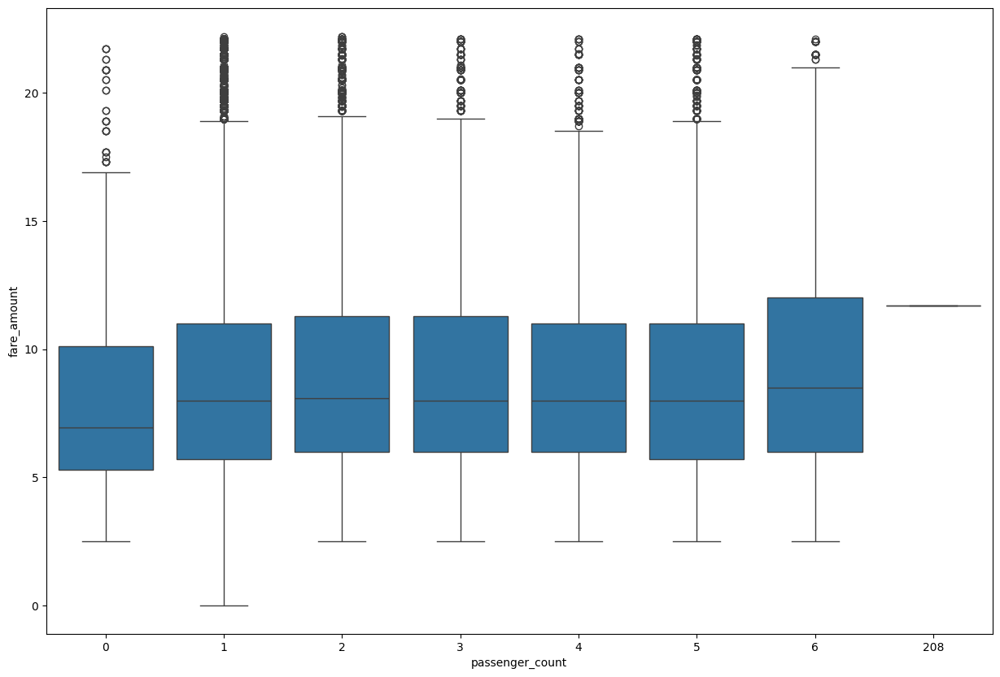

In [49]:
plt.figure(figsize=(15,10))
sns.boxplot(x=df['passenger_count'] , y=df['fare_amount'])

We can observe that fare do not vary much with passenger count. Also we have one wrong entry of 208 passengers

In [52]:
df = df[df['passenger_count']<6]

In [61]:
X = df.iloc[:,1:]
y = df.iloc[:,0]

In [62]:
from sklearn.model_selection import train_test_split
X_train , X_test , y_train , y_test = train_test_split(X , y , test_size=0.2 , random_state=10)
X_train.shape , y_train.shape

((143158, 9), (143158,))

In [65]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_train_scaled

array([[-0.14105492,  0.13793428, -0.14243087, ..., -1.23779591,
         0.71632317,  0.83914591],
       [-0.14109396,  0.13723415, -0.14254422, ..., -0.65651372,
         0.71632317, -0.08212342],
       [-0.14080133,  0.1415949 , -0.13765874, ..., -0.36587263,
         1.79640608,  1.14623568],
       ...,
       [-0.14214147,  0.13223673, -0.14088141, ..., -0.07523154,
         1.79640608, -1.92466208],
       [-0.13959028,  0.13652111, -0.14098885, ..., -0.65651372,
        -1.44384265, -2.07820697],
       [-0.14086802,  0.14134012, -0.14123556, ..., -0.36587263,
        -0.36375974,  0.53205613]])

In [66]:
X_test_scaled = scaler.transform(X_test)
X_test_scaled

array([[-0.1418009 ,  0.13452282, -0.14066782, ...,  1.08733284,
        -0.9038012 ,  0.37851124],
       [-0.14163621,  0.13296452, -0.14023314, ...,  1.37797393,
        -1.44384265,  0.53205613],
       [-0.14109627,  0.14047302, -0.14005272, ...,  0.79669174,
        -0.9038012 , -0.84984786],
       ...,
       [ 6.97184676, -6.60716373,  7.00895236, ..., -0.36587263,
         0.17628171,  1.45332546],
       [-0.14263245,  0.1352059 , -0.13759737, ..., -0.65651372,
        -1.44384265, -2.07820697],
       [-0.1403325 ,  0.13654825, -0.14060645, ...,  1.08733284,
        -1.44384265, -1.00339275]])

In [106]:
from sklearn.linear_model import LinearRegression , Lasso

lr = LinearRegression()
lr.fit(X_train_scaled , y_train)

LinearRegression()

In [107]:
y_pred = lr.predict(X_test_scaled)
y_pred

array([8.69694862, 8.27778863, 8.58780159, ..., 8.77444497, 8.22894812,
       8.46774921])

In [108]:
from sklearn.metrics import r2_score
r2_score(y_test , y_pred)*100

2.0307505014834026

In [109]:
lasso  = Lasso(alpha=0.0041)
lasso.fit(X_train_scaled , y_train)
y_pred = lasso.predict(X_test_scaled)
r2_score(y_test , y_pred)*100

2.0357836297318244

In [111]:
from sklearn.ensemble import RandomForestRegressor
rf = RandomForestRegressor()
rf.fit(X_train_scaled , y_train)
y_pred = rf.predict(X_test_scaled)
r2_score(y_test , y_pred)

0.7556776823295153

Linear models are not giving good accuracy but Random Forest is giving good accuracy

In [115]:
import pickle
pickle.dump(rf , open('model_fare_pred.pkl' , 'wb')) 